<a href="https://colab.research.google.com/github/hatemrizk/videoautoqa/blob/main/Automatic_Question_Generation_From_Video_Content_Hatem_Rizk.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


#Automatic Question Generation from Video Content for Use in Cognitive Assessments.
---
Periodic cognitive health assessments are an important tool in diagnostics of several health conditions including Delirium, Dementia, and/or Depression. These tests aid medical professionals evaluate the severity and progression of cognitive impairment. The most widely used tool in cognitive assessment today is the Mini-Mental State Examination (MMSE), which developed in 1975. The test is a 30-point questionnaire which examines functions including Orientation, Registration, Attention, Calculator, Recall, Language, as well as, Copying. Several studies have linked the increase in administering the copy-righted test with overall health care savings and improved quality of life in the elders. However, this test was found to be less sensitive to mild changes in cognitive behavior, lacking ability to detect progeressive changes in Alzheimer, and affected by age, education, and cultural background. In this project, we aim to improve cognitive testing by using Natural Language Processing (NLP) and Deep Learning Object Detection technologies to assess a patient's cognitive abilities. 


---

The below questions can be used as part of an online congnitive assessment applications for measuring a patient's Registration, Attention, and Recall.


In [ ]:
#Install the youtube-transcript-api library
!pip install --quiet youtube_transcript_api

In [ ]:
!python --version

Python 3.7.15


# Download Video Captions

The youtube-transcript-api is used here to download caption information for a given Youtube video. The library can be referenced by accessing the link below:
https://pypi.org/project/youtube-transcript-api/

In [ ]:
#Import library
from youtube_transcript_api import YouTubeTranscriptApi

video_link = 'https://www.youtube.com/watch?v=LZDfGiXJjjI&t=5s'

#Extract video id
video_id = video_link.split('watch?v=')[1]

#Download caption information
subtitles = YouTubeTranscriptApi.get_transcript(video_id=video_id, languages=['en'])
#transcript_list = YouTubeTranscriptApi.list_transcripts(video_id)
print(subtitles)

[{'text': '[Music]', 'start': 5.17, 'duration': 12.5}, {'text': '[Music]', 'start': 23.66, 'duration': 6.449}, {'text': '[Music]', 'start': 35.04, 'duration': 14.88}, {'text': 'arabia an ancient and mysterious land', 'start': 46.399, 'duration': 6.081}, {'text': "underneath saudi's islamic regime and", 'start': 49.92, 'duration': 5.6}, {'text': 'its rich oil resources lies many untold', 'start': 52.48, 'duration': 4.559}, {'text': 'truths', 'start': 55.52, 'duration': 4.559}, {'text': 'these discoveries recently led many to', 'start': 57.039, 'duration': 5.921}, {'text': 'believe this land to be in fact the lost', 'start': 60.079, 'duration': 6.521}, {'text': 'land of moses', 'start': 62.96, 'duration': 3.64}, {'text': '[Music]', 'start': 73.12, 'duration': 3.409}, {'text': 'join us as we reveal to you the biblical', 'start': 78.799, 'duration': 7.481}, {'text': 'proofs behind these sites', 'start': 81.92, 'duration': 4.36}, {'text': '[Music]', 'start': 86.49, 'duration': 15.52}, {'tex

In [ ]:
#Import pandas library and convert to dataframe
import pandas as pd

subtitles_df = pd.DataFrame(subtitles)

In [ ]:
#Inspect results
subtitles_df.head(10)

,text,start,duration
3,arabia an ancient and mysterious land,46.399,6.081
4,underneath saudi's islamic regime and,49.920,5.600
5,its rich oil resources lies many untold,52.480,4.559
6,truths,55.520,4.559
7,these discoveries recently led many to,57.039,5.921
8,believe this land to be in fact the lost,60.079,6.521
9,land of moses,62.960,3.640
11,join us as we reveal to you the biblical,78.799,7.481
12,proofs behind these sites,81.920,4.360
14,it is time everyone knows god's words,102.880,6.000


# Cleanup of Downloaded Captions

The caption records downloaded have snippets of text and video timeframes associated with these captions. In cells below we remove any irrelevent text and remove any special characters.

In [ ]:
subtitles_df['text'] = subtitles_df['text'].apply(lambda x: x.replace("-", "") if "-" in x else x) 

In [ ]:
#Remove records for [Music] captions
subtitles_df = subtitles_df[subtitles_df['text'] != '[Music]']

In [ ]:
#Inspect results
subtitles_df.head(30)

,text,start,duration
3,arabia an ancient and mysterious land,46.399,6.081
4,underneath saudi's islamic regime and,49.920,5.600
5,its rich oil resources lies many untold,52.480,4.559
6,truths,55.520,4.559
7,these discoveries recently led many to,57.039,5.921
8,believe this land to be in fact the lost,60.079,6.521
9,land of moses,62.960,3.640
11,join us as we reveal to you the biblical,78.799,7.481
12,proofs behind these sites,81.920,4.360
14,it is time everyone knows god's words,102.880,6.000


In [ ]:
remove_index_list = subtitles_df.index[(subtitles_df.text.str[:1] == "(") | (subtitles_df.text.str[:1] == ">")].tolist()

In [ ]:
subtitles_df.iloc[remove_index_list]

,text,start,duration


In [ ]:
subtitles_df.drop(remove_index_list, inplace=True)

In [ ]:
subtitles_df.head()

,text,start,duration
3,arabia an ancient and mysterious land,46.399,6.081
4,underneath saudi's islamic regime and,49.920,5.600
5,its rich oil resources lies many untold,52.480,4.559
6,truths,55.520,4.559
7,these discoveries recently led many to,57.039,5.921


# Create Text Corpus 

Below we combine all indivial caption strings into one text corpus. Note that the text is missing all puncations. This will affect accuracy of downstream NLP processing. To fix this, we use an NLP model called *rpunct* to add back puncations and create more meaningful text. The rpunct package works to   restore punctations on arbitrarily large texts and uses theHuggingFace's bert-base-uncased model weights that have been fine-tuned for Punctuation restoration. It can be fined tuned to specific domains but in our case, it worked fine without any further fine-tuning.

In [ ]:
#Combine caption snippets into one text corpus
#Note lack of puncuations.
caption_text = subtitles_df.text.str.cat(sep=" ")
print(caption_text)

arabia an ancient and mysterious land underneath saudi's islamic regime and its rich oil resources lies many untold truths these discoveries recently led many to believe this land to be in fact the lost land of moses join us as we reveal to you the biblical proofs behind these sites it is time everyone knows god's words are infallible and that his stories are true i present to you the real mount sinai unveiling the secrets of arabia for centuries the presently accepted location of the mountain being the sinai peninsula in egypt has been debated by many scholars the early chapters of exodus tells us in fact that mount sinai is in midian which is in saudi arabia at age 40 moses fled from the face of pharaoh in egypt and dwelt in the land of midian moses was standing the flock of jethro his fatherinlaw the priest of midian and he led the flock to the back of the desert and came to the mountain of god this is where moses encountered god in the burning bush god gave him an important command

In [ ]:
len(caption_text)

9428

In [ ]:
!pip install --quiet rpunct

     |████████████████████████████████| 804.1 MB 2.5 kB/s 
     |████████████████████████████████| 981 kB 59.9 MB/s 
     |████████████████████████████████| 213 kB 88.5 MB/s 
     |████████████████████████████████| 9.9 MB 64.2 MB/s 
     |████████████████████████████████| 9.2 MB 82.4 MB/s 
     |████████████████████████████████| 441 kB 89.5 MB/s 
     |████████████████████████████████| 125 kB 78.4 MB/s 
     |████████████████████████████████| 1.9 MB 53.4 MB/s 
     |████████████████████████████████| 43 kB 1.6 MB/s 
     |████████████████████████████████| 1.3 MB 60.6 MB/s 
     |████████████████████████████████| 115 kB 92.5 MB/s 
     |████████████████████████████████| 95 kB 4.5 MB/s 
     |████████████████████████████████| 212 kB 94.9 MB/s 
     |████████████████████████████████| 127 kB 75.0 MB/s 
     |████████████████████████████████| 115 kB 75.0 MB/s 
     |████████████████████████████████| 182 kB 78.9 MB/s 
     |████████████████████████████████| 237 kB 68.5 MB/s 
     |███████████

In [ ]:
#Import library
from rpunct import RestorePuncts

#Instantiate model
rpunct = RestorePuncts()

#Generate new text with puncuations added.
cap_txt_punct_added = rpunct.punctuate(caption_text)

Downloading:   0%|          | 0.00/1.25k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/436M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/530 [00:00<?, ?B/s]

In [ ]:
#Caption corpus with puncuations restored
print(cap_txt_punct_added)

Arabia, an ancient and mysterious land. underneath Saudi's Islamic regime and its rich oil resources lies many untold truths. These discoveries recently led many to believe this land to be in fact, the lost land of Moses. Join us as we reveal to you the biblical proofs behind these sites. It is time. Everyone knows God's words are infallible and that his stories are true. I present to you the real Mount Sinai, unveiling the secrets of Arabia. For centuries, the presently accepted location of the mountain, being the Sinai Peninsula in Egypt, has been debated by many scholars. The early chapters of Exodus tells us in fact that Mount Sinai is in Midian, which is in Saudi Arabia. At age 40, Moses fled from the face of Pharaoh in Egypt and dwelt in the land of Midian. Moses was standing the flock of Jethro, his fatherinlaw, the priest of Midian, and he led the flock to the back of the desert and came to the mountain of God. This is where Moses encountered God in the burning bush. God gave h

# Application of Name Entity Recognition NLP Techniques

In the following section we download a pretrained N*ame Entity Recognition (NER)* tokenizer and model from the *HuggingFace* library to extract useful information from our downloaded captions including Persons, Locations, Organizations, and Misc entities. We can then use this information in subsequent steps to generate questions based on content within the video.

In [ ]:
!pip install --quiet transformers

In [ ]:
from transformers import AutoTokenizer, AutoModelForTokenClassification
from transformers import pipeline
import pandas as pd

checkpoint = "Jean-Baptiste/roberta-large-ner-english"
#checkpoint = "xlm-roberta-large-finetuned-conll03-english"
#checkpoint = "dslim/bert-base-NER"
tokenizer = AutoTokenizer.from_pretrained(checkpoint )
model = AutoModelForTokenClassification.from_pretrained(checkpoint)

ner_tagger = pipeline("ner", model=model, tokenizer=tokenizer, aggregation_strategy="simple")

ner_outputs = pd.DataFrame(ner_tagger(caption_text))

Downloading:   0%|          | 0.00/255 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/849 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/798k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/239 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

In [ ]:
ner_outputs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49 entries, 0 to 48
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   entity_group  49 non-null     object 
 1   score         49 non-null     float32
 2   word          49 non-null     object 
 3   start         49 non-null     int64  
 4   end           49 non-null     int64  
dtypes: float32(1), int64(2), object(2)
memory usage: 1.8+ KB


In [ ]:
ner_outputs

,entity_group,score,word,start,end
0,LOC,0.999560,arabia,0,6
1,LOC,0.986841,saudi,49,54
2,MISC,0.998583,islamic,57,64
3,PER,0.977511,moses,211,216
4,PER,0.990148,god,310,313
5,LOC,0.962482,mount sinai,393,404
6,LOC,0.998345,arabia,430,436
7,LOC,0.997595,sinai,509,514
8,LOC,0.999757,egypt,528,533
9,MISC,0.939641,exodus,590,596


In [ ]:
#Create a list of top ten tagged keywords
top_10_entities = [s.strip() for s in ner_outputs.word.unique()[:10]]
print(top_10_entities)

['arabia', 'saudi', 'islamic', 'moses', 'god', 'mount sinai', 'sinai', 'egypt', 'exodus', 'midian']


In [ ]:
import nltk
nltk.download('punkt')
from nltk.tokenize import sent_tokenize

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
#Use nltk library function sent_tokenize to split our caption curpus back into sentences which will be used for context in later processing.
subtitles_punct_df = pd.DataFrame(sent_tokenize(cap_txt_punct_added), columns = ['text'])

In [ ]:
subtitles_punct_df 

,text
0,"Arabia, an ancient and mysterious land."
1,underneath Saudi's Islamic regime and its rich oil resources lies many untold truths.
2,"These discoveries recently led many to believe this land to be in fact, the lost land of Moses."
3,Join us as we reveal to you the biblical proofs behind these sites.
4,It is time.
...,...
110,Many will try to enter but will not be able.
111,Not everyone that says lord Lord will enter the kingdom of God.
112,Only the ones who do the will of my father in heaven and God promised to the overcomers.
113,I will give them the crown of eternal life.


# Application of Automatic Question Generation NLP Techniques

In the following section we download a pretrained *t5-based transfomer* tokenizer and model from the *HuggingFace* library which has been fined tuned to generate questions given an answer and a context. The following steps, eWe use this top ten keywords generated using the NER tagger along with relevant context to generate a list of questions based on content within the video.

In [ ]:
pd.set_option('display.max_colwidth', None)

In [ ]:
from transformers import AutoModelWithLMHead, AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("mrm8488/t5-base-finetuned-question-generation-ap")
model = AutoModelWithLMHead.from_pretrained("mrm8488/t5-base-finetuned-question-generation-ap")

def get_question(answer, context, max_length=64):
  input_text = "answer: %s  context: %s </s>" % (answer, context)
  features = tokenizer([input_text], return_tensors='pt')

  output = model.generate(input_ids=features['input_ids'], 
               attention_mask=features['attention_mask'],
               max_length=max_length)

  return tokenizer.decode(output[0],skip_special_tokens=True)

The `xla_device` argument has been deprecated in v4.4.0 of Transformers. It is ignored and you can safely remove it from your `config.json` file.
The `xla_device` argument has been deprecated in v4.4.0 of Transformers. It is ignored and you can safely remove it from your `config.json` file.
The `xla_device` argument has been deprecated in v4.4.0 of Transformers. It is ignored and you can safely remove it from your `config.json` file.
/usr/local/lib/python3.7/dist-packages/transformers/models/auto/modeling_auto.py:1136: FutureWarning: The class `AutoModelWithLMHead` is deprecated and will be removed in a future version. Please use `AutoModelForCausalLM` for causal language models, `AutoModelForMaskedLM` for masked language models and `AutoModelForSeq2SeqLM` for encoder-decoder models.
  FutureWarning,
The `xla_device` argument has been deprecated in v4.4.0 of Transformers. It is ignored and you can safely remove it from your `config.json` file.


In [ ]:
generated_qa = []
for e in top_10_entities:
  context_list = subtitles_punct_df[subtitles_punct_df.text.str.contains(e.title())]['text'].to_list()
  for c in context_list:
    context = c
    answer = e
    question = get_question(answer, context).replace("question: ", "")
    generated_qa.append([question, answer.title(), context])
generated_qa_df = pd.DataFrame(generated_qa, columns=["Question", "Answer", "Context"])

In [ ]:
generated_qa_df['Answer'].unique()

array(['Arabia', 'Saudi', 'Islamic', 'Moses', 'God', 'Mount Sinai',
       'Sinai', 'Egypt', 'Exodus', 'Midian'], dtype=object)

# Examples of AI Generated Questions from Video Content (TEXT CAPTIONS)

Below are good examples for some of the keywords. Some limitations include inaccuracies by the NER tagger in recpnizing Saudi Arabia as one entity.

In [ ]:
generated_qa_df[generated_qa_df['Answer']=='Midian'].head(5)

,Question,Answer,Context
86,Where is Mount Sinai located?,Midian,"The early chapters of Exodus tells us in fact that Mount Sinai is in Midian, which is in Saudi Arabia."
87,Where did Moses live?,Midian,"At age 40, Moses fled from the face of Pharaoh in Egypt and dwelt in the land of Midian."
88,What city was Jethro a priest from?,Midian,"Moses was standing the flock of Jethro, his fatherinlaw, the priest of Midian, and he led the flock to the back of the desert and came to the mountain of God."


In [ ]:
generated_qa_df[generated_qa_df['Answer']=='Mount Sinai'].head(5)

,Question,Answer,Context
52,What is the real name of the mountain?,Mount Sinai,"I present to you the real Mount Sinai, unveiling the secrets of Arabia."
53,What is the name of the mountain in Midian?,Mount Sinai,"The early chapters of Exodus tells us in fact that Mount Sinai is in Midian, which is in Saudi Arabia."
54,What did Wyatt believe he would find in Median?,Mount Sinai,"In 1984, Archaeologist Ron Wyatt went to Median where he also believed he would find the real Mount Sinai."
55,What is the name of the mountain that is northwest of Mount Sinai?,Mount Sinai,"The northwest of Mount Sinai is a split rock of Horeb, standing on the crest of a hill."
56,What is the name of the mountain that is still present today?,Mount Sinai,"According to the 12 Tribes of Israel, A structure can still be found today at the base of Mount Sinai."


In [ ]:
generated_qa_df[generated_qa_df['Answer']=='Exodus'].head(5)

,Question,Answer,Context
85,What book tells us that Mount Sinai is in Midian?,Exodus,"The early chapters of Exodus tells us in fact that Mount Sinai is in Midian, which is in Saudi Arabia."


# AI Generated Questions Using Video Activity Identification Techniques

In the following sections we download a couple of videos from YouTube and use AI to classify activities in a given set of frames from each video which is used to generate a question to the viewer. 

In [ ]:
!pip install --quiet pytube
!pip install --quiet decord
!pip install --quiet transformers

     |████████████████████████████████| 56 kB 2.4 MB/s 
     |████████████████████████████████| 13.6 MB 3.6 MB/s 
     |████████████████████████████████| 5.5 MB 4.1 MB/s 
     |████████████████████████████████| 7.6 MB 72.5 MB/s 
     |████████████████████████████████| 182 kB 94.7 MB/s 


In [ ]:
from pytube import YouTube
video_link = "https://www.youtube.com/watch?v=LZDfGiXJjjI&t=5s"
yt = YouTube(video_link)

In [ ]:
print(yt.title)

The Real Mount Sinai - Shocking Exodus Evidence in Saudi Arabia I 4K Short Documentary 2022 [SHARE]


In [ ]:
import cv2 as cv 
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from PIL import Image 

In [ ]:
yt.streams.all()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated function all (This object can be treated as a list, all() is useless).
  """Entry point for launching an IPython kernel.


[<Stream: itag="17" mime_type="video/3gpp" res="144p" fps="6fps" vcodec="mp4v.20.3" acodec="mp4a.40.2" progressive="True" type="video">,
 <Stream: itag="18" mime_type="video/mp4" res="360p" fps="25fps" vcodec="avc1.42001E" acodec="mp4a.40.2" progressive="True" type="video">,
 <Stream: itag="22" mime_type="video/mp4" res="720p" fps="25fps" vcodec="avc1.64001F" acodec="mp4a.40.2" progressive="True" type="video">,
 <Stream: itag="313" mime_type="video/webm" res="2160p" fps="25fps" vcodec="vp9" progressive="False" type="video">,
 <Stream: itag="271" mime_type="video/webm" res="1440p" fps="25fps" vcodec="vp9" progressive="False" type="video">,
 <Stream: itag="137" mime_type="video/mp4" res="1080p" fps="25fps" vcodec="avc1.640028" progressive="False" type="video">,
 <Stream: itag="248" mime_type="video/webm" res="1080p" fps="25fps" vcodec="vp9" progressive="False" type="video">,
 <Stream: itag="136" mime_type="video/mp4" res="720p" fps="25fps" vcodec="avc1.4d401f" progressive="False" type="v

In [ ]:
stream = yt.streams[2]

In [ ]:
stream.download()

'/content/The Real Mount Sinai - Shocking Exodus Evidence in Saudi Arabia I 4K Short Documentary 2022 [SHARE].mp4'

In [ ]:
from decord import VideoReader
from decord import cpu, gpu
filename = "/content/The Real Mount Sinai - Shocking Exodus Evidence in Saudi Arabia I 4K Short Documentary 2022 [SHARE].mp4"
vr = VideoReader(filename, ctx=cpu(0))
# a file like object works as well, for in-memory decoding
with open(filename, 'rb') as f:
  vr = VideoReader(f, ctx=cpu(0))
print('video frames:', len(vr))
# 1. the simplest way is to directly access frames
#
#for i in range(len(vr)):
    # the video reader will handle seeking and skipping in the most efficient manner
#    frame = vr[i]
#    print(frame.shape)

# To get multiple frames at once, use get_batch
# this is the efficient way to obtain a long list of frames
#frames = vr.get_batch([1, 3, 5, 7, 9])
#print(frames.shape)
# (5, 240, 320, 3)
# duplicate frame indices will be accepted and handled internally to avoid duplicate decoding
#frames2 = vr.get_batch([1, 2, 3, 2, 3, 4, 3, 4, 5]).asnumpy()
#print(frames2.shape)
# (9, 240, 320, 3)

# 2. you can do cv2 style reading as well
# skip 100 frames
#vr.skip_frames(100)
# seek to start
#vr.seek(0)
#batch = vr.next()
#print('frame shape:', batch.shape)
#print('numpy frames:', batch.asnumpy())


video frames: 31750


In [ ]:
frame = vr[2000]
print(frame.shape)

(720, 1280, 3)


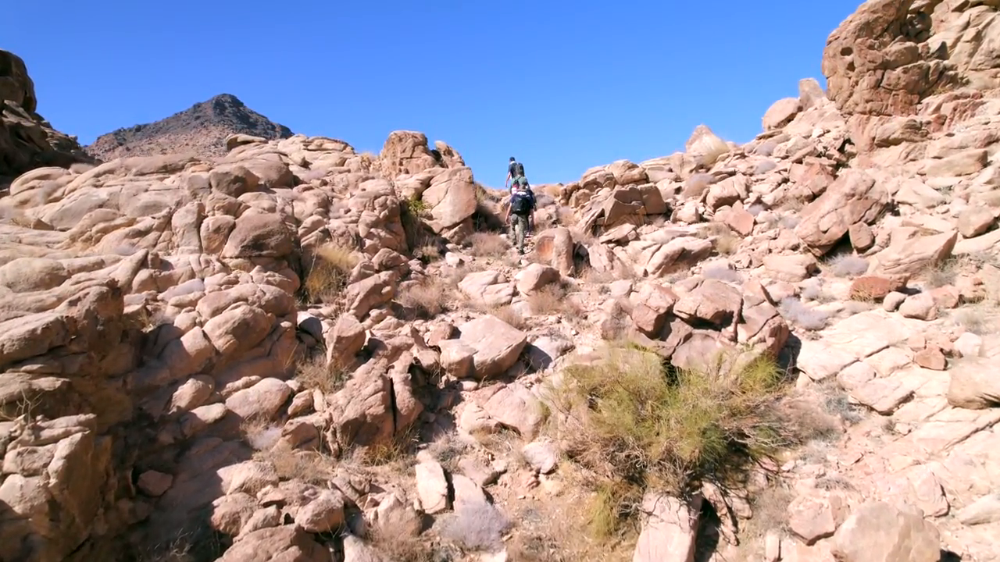

In [ ]:
#Display of video frame number 2000 showing hiking activity
cv2_imshow(cv.cvtColor(frame.asnumpy(), cv.COLOR_BGR2RGB))

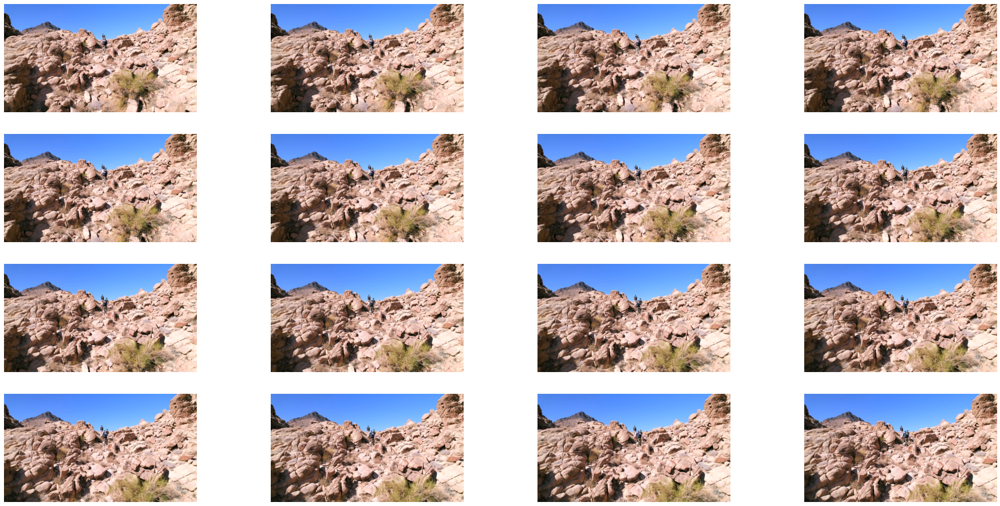

In [ ]:
#Display of 16 consecutive frames showing hiking activity
ef disp_batches(video_reader, batch_indices, max_disp=5):
    %matplotlib inline
    from matplotlib import pyplot as plt
    import matplotlib.gridspec as gridspec
    cnt = 9
    data = vr.get_batch(batch_indices).asnumpy()
    columns = 4
    rows = max(1, (data.shape[0] + 1) // columns)
    fig = plt.figure(figsize = (32,(16 // columns) * rows))
    gs = gridspec.GridSpec(rows, columns)
    for i in range(data.shape[0]):
        plt.subplot(gs[i])
        plt.axis("off")
        plt.imshow(data[i])
    cnt += 1

n=2000
batch_indices = list(range(n, n+16*2, 2))
disp_batches(vr, batch_indices , 5)

# Using VideoMAE for Activity Identification In Youtube Video

In the following steps we import a pretrained VideoMAE Masked Autoencoder from the HuggingFace Library and use it to succesfully classify the activity in this batch of frames shown above. More information about VideoMAE: Masked Autoencoders can be found here.  https://arxiv.org/abs/2203.12602

In [ ]:
import torch
import numpy as np
from transformers import VideoMAEFeatureExtractor, VideoMAEForVideoClassification

np.random.seed(0)


vr.seek(0)

# sample 16 frames

video = vr.get_batch(batch_indices).asnumpy()

feature_extractor = VideoMAEFeatureExtractor.from_pretrained("MCG-NJU/videomae-base-finetuned-kinetics")
model = VideoMAEForVideoClassification.from_pretrained("MCG-NJU/videomae-base-finetuned-kinetics")

inputs = feature_extractor(list(video), return_tensors="pt")

with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits

# model predicts one of the 400 Kinetics-400 classes
predicted_label = logits.argmax(-1).item()
print(model.config.id2label[predicted_label])

rock climbing


In [ ]:
from pytube import YouTube
import cv2 as cv 
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from PIL import Image 

video_link= "https://www.youtube.com/watch?v=ZbW5J8hwEag"

yt = YouTube(video_link)

In [ ]:
yt.streams.all()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated function all (This object can be treated as a list, all() is useless).
  """Entry point for launching an IPython kernel.


[<Stream: itag="17" mime_type="video/3gpp" res="144p" fps="12fps" vcodec="mp4v.20.3" acodec="mp4a.40.2" progressive="True" type="video">,
 <Stream: itag="18" mime_type="video/mp4" res="360p" fps="24fps" vcodec="avc1.42001E" acodec="mp4a.40.2" progressive="True" type="video">,
 <Stream: itag="22" mime_type="video/mp4" res="720p" fps="24fps" vcodec="avc1.64001F" acodec="mp4a.40.2" progressive="True" type="video">,
 <Stream: itag="137" mime_type="video/mp4" res="1080p" fps="24fps" vcodec="avc1.640028" progressive="False" type="video">,
 <Stream: itag="248" mime_type="video/webm" res="1080p" fps="24fps" vcodec="vp9" progressive="False" type="video">,
 <Stream: itag="136" mime_type="video/mp4" res="720p" fps="24fps" vcodec="avc1.64001f" progressive="False" type="video">,
 <Stream: itag="247" mime_type="video/webm" res="720p" fps="24fps" vcodec="vp9" progressive="False" type="video">,
 <Stream: itag="135" mime_type="video/mp4" res="480p" fps="24fps" vcodec="avc1.4d401e" progressive="False" t

In [ ]:
stream = yt.streams[1]

In [ ]:
stream.download()

'/content/Things to do in Maui - Travel Guide.mp4'

In [ ]:
from decord import VideoReader
from decord import cpu, gpu


In [ ]:
filename = "/content/Things to do in Maui - Travel Guide.mp4"

In [ ]:
vr = VideoReader(filename, ctx=cpu(0))
# a file like object works as well, for in-memory decoding
with open(filename, 'rb') as f:
  vr = VideoReader(f, ctx=cpu(0))
print('video frames:', len(vr))

video frames: 9917


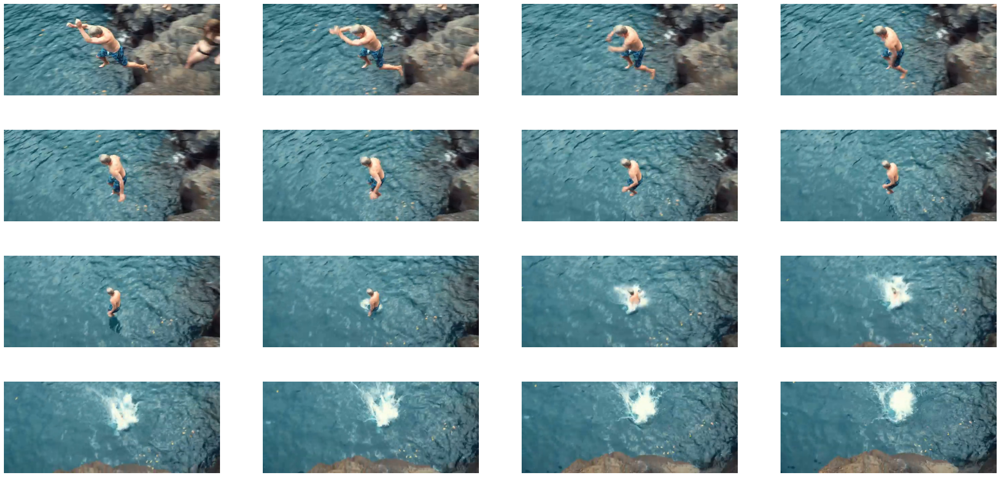

In [ ]:
def disp_batches(video_reader, batch_indices, max_disp=5):
    %matplotlib inline
    from matplotlib import pyplot as plt
    import matplotlib.gridspec as gridspec
    cnt = 9
    data = vr.get_batch(batch_indices).asnumpy()
    columns = 4
    rows = max(1, (data.shape[0] + 1) // columns)
    fig = plt.figure(figsize = (32,(16 // columns) * rows))
    gs = gridspec.GridSpec(rows, columns)
    for i in range(data.shape[0]):
        plt.subplot(gs[i])
        plt.axis("off")
        plt.imshow(data[i])
    cnt += 1

n=1080
batch_indices = list(range(n, n+16*2, 2))
disp_batches(vr, batch_indices , 5)

In [ ]:
import numpy as np
import torch
from transformers import VideoMAEFeatureExtractor, VideoMAEModel
from transformers import VideoMAEFeatureExtractor, VideoMAEForVideoClassification


vr.seek(0)

# sample 16 frames

video = vr.get_batch(batch_indices).asnumpy()

feature_extractor = VideoMAEFeatureExtractor.from_pretrained("MCG-NJU/videomae-base-finetuned-kinetics")
model = VideoMAEForVideoClassification.from_pretrained("MCG-NJU/videomae-base-finetuned-kinetics")

inputs = feature_extractor(list(video), return_tensors="pt")

with torch.no_grad():
    outputs = model(**inputs)
    logits = outputs.logits

# model predicts one of the 400 Kinetics-400 classes
predicted_label = logits.argmax(-1).item()
print(model.config.id2label[predicted_label])

diving cliff


In [ ]:
!nvidia-smi

Thu Nov 17 09:30:31 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   52C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!free -h --si | awk  '/Mem:/{print $2}'

26G


In [ ]:
!lscpu 

Architecture:        x86_64
CPU op-mode(s):      32-bit, 64-bit
Byte Order:          Little Endian
CPU(s):              4
On-line CPU(s) list: 0-3
Thread(s) per core:  2
Core(s) per socket:  2
Socket(s):           1
NUMA node(s):        1
Vendor ID:           GenuineIntel
CPU family:          6
Model:               79
Model name:          Intel(R) Xeon(R) CPU @ 2.20GHz
Stepping:            0
CPU MHz:             2199.998
BogoMIPS:            4399.99
Hypervisor vendor:   KVM
Virtualization type: full
L1d cache:           32K
L1i cache:           32K
L2 cache:            256K
L3 cache:            56320K
NUMA node0 CPU(s):   0-3
Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc rep_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm abm 3dnowprefetch invpcid_sin

In [ ]:
#!pip install --quiet pytube
#!pip install --quiet decord
#!pip install --quiet transformers

In [ ]:
import os
no_of_frames = 16

# Video file path
path_to_video = os.path.abspath(filename)
path_to_frames = os.path.join(os.path.dirname(path_to_video), filename.split(".")[0]+"key_frames")
try:
  os.makedirs(path_to_frames)
except:
  print("File exists!")

File exists!


In [ ]:
#These helper functions are from the PeakUtils 1.3.3
#And Are Used By the key-frame-detector functions below.
#https://peakutils.readthedocs.io/en/latest/

"""Peak detection algorithms."""

import warnings

import numpy as np
from scipy import optimize
from scipy.integrate import simps
import scipy.linalg as LA
import math


eps = np.finfo(float).eps


def indexes(y, thres=0.3, min_dist=1, thres_abs=False):
    """Peak detection routine.

    Finds the numeric index of the peaks in *y* by taking its first order difference. By using
    *thres* and *min_dist* parameters, it is possible to reduce the number of
    detected peaks. *y* must be signed.

    Parameters
    ----------
    y : ndarray (signed)
        1D amplitude data to search for peaks.
    thres : float between [0., 1.]
        Normalized threshold. Only the peaks with amplitude higher than the
        threshold will be detected.
    min_dist : int
        Minimum distance between each detected peak. The peak with the highest
        amplitude is preferred to satisfy this constraint.
    thres_abs: boolean
        If True, the thres value will be interpreted as an absolute value, instead of
        a normalized threshold.

    Returns
    -------
    ndarray
        Array containing the numeric indexes of the peaks that were detected.
        When using with Pandas DataFrames, iloc should be used to access the values at the returned positions.
    """
    if isinstance(y, np.ndarray) and np.issubdtype(y.dtype, np.unsignedinteger):
        raise ValueError("y must be signed")

    if not thres_abs:
        thres = thres * (np.max(y) - np.min(y)) + np.min(y)

    min_dist = int(min_dist)

    # compute first order difference
    dy = np.diff(y)

    # propagate left and right values successively to fill all plateau pixels (0-value)
    zeros, = np.where(dy == 0)

    # check if the signal is totally flat
    if len(zeros) == len(y) - 1:
        return np.array([], dtype=np.int64)

    if len(zeros):
        # compute first order difference of zero indexes
        zeros_diff = np.diff(zeros)
        # check when zeros are not chained together
        zeros_diff_not_one, = np.add(np.where(zeros_diff != 1), 1)
        # make an array of the chained zero indexes
        zero_plateaus = np.split(zeros, zeros_diff_not_one)

        # fix if leftmost value in dy is zero
        if zero_plateaus[0][0] == 0:
            dy[zero_plateaus[0]] = dy[zero_plateaus[0][-1] + 1]
            zero_plateaus.pop(0)

        # fix if rightmost value of dy is zero
        if len(zero_plateaus) and zero_plateaus[-1][-1] == len(dy) - 1:
            dy[zero_plateaus[-1]] = dy[zero_plateaus[-1][0] - 1]
            zero_plateaus.pop(-1)

        # for each chain of zero indexes
        for plateau in zero_plateaus:
            median = np.median(plateau)
            # set leftmost values to leftmost non zero values
            dy[plateau[plateau < median]] = dy[plateau[0] - 1]
            # set rightmost and middle values to rightmost non zero values
            dy[plateau[plateau >= median]] = dy[plateau[-1] + 1]

    # find the peaks by using the first order difference
    peaks = np.where(
        (np.hstack([dy, 0.0]) < 0.0)
        & (np.hstack([0.0, dy]) > 0.0)
        & (np.greater(y, thres))
    )[0]

    # handle multiple peaks, respecting the minimum distance
    if peaks.size > 1 and min_dist > 1:
        highest = peaks[np.argsort(y[peaks])][::-1]
        rem = np.ones(y.size, dtype=bool)
        rem[peaks] = False

        for peak in highest:
            if not rem[peak]:
                sl = slice(max(0, peak - min_dist), peak + min_dist + 1)
                rem[sl] = True
                rem[peak] = False

        peaks = np.arange(y.size)[~rem]

    return peaks

def baseline(y, deg=None, max_it=None, tol=None):
    """
    Computes the baseline of a given data.

    Iteratively performs a polynomial fitting in the data to detect its
    baseline. At every iteration, the fitting weights on the regions with
    peaks are reduced to identify the baseline only.

    Parameters
    ----------
    y : ndarray
        Data to detect the baseline.
    deg : int (default: 3)
        Degree of the polynomial that will estimate the data baseline. A low
        degree may fail to detect all the baseline present, while a high
        degree may make the data too oscillatory, especially at the edges.
    max_it : int (default: 100)
        Maximum number of iterations to perform.
    tol : float (default: 1e-3)
        Tolerance to use when comparing the difference between the current
        fit coefficients and the ones from the last iteration. The iteration
        procedure will stop when the difference between them is lower than
        *tol*.

    Returns
    -------
    ndarray
        Array with the baseline amplitude for every original point in *y*
    """
    # for not repeating ourselves in `envelope`
    if deg is None: deg = 3
    if max_it is None: max_it = 100
    if tol is None: tol = 1e-3
    
    order = deg + 1
    coeffs = np.ones(order)

    # try to avoid numerical issues
    cond = math.pow(abs(y).max(), 1. / order)
    x = np.linspace(0., cond, y.size)
    base = y.copy()

    vander = np.vander(x, order)
    vander_pinv = LA.pinv(vander)

    for _ in range(max_it):
        coeffs_new = np.dot(vander_pinv, y)

        if LA.norm(coeffs_new - coeffs) / LA.norm(coeffs) < tol:
            break

        coeffs = coeffs_new
        base = np.dot(vander, coeffs)
        y = np.minimum(y, base)

    return base


# The Video Keyframe Detector function is used to detect keyframes in the downloaded videos which makes is easy to classify our summarize our video activities in later stages. This code has been modified to extract the actualy key frame number in the video sequence for later use in XMEVideo ACtivity detection.

In [ ]:
   #    https://github.com/joelibaceta/video-keyframe-detector
#    description="It is a simple python tool to extract key frame images from a video file",
#    name="key-frame-detector",
#    version="1.0.0",
#    author="Joel Ibaceta",
#    author_email="mail@joelibaceta.com",
#    license='MIT',

 
import matplotlib.pyplot as plt
from PIL import Image
import os
import cv2
import csv
import numpy as np
import time
import math

def keyframeDetection(source, dest, Thres, plotMetrics=False, verbose=False):
    
    keyframePath = dest+'/keyFrames'
    imageGridsPath = dest+'/imageGrids'
    csvPath = dest+'/csvFile'
    path2file = csvPath + '/output.csv'
    prepare_dirs(keyframePath, imageGridsPath, csvPath)

    cap = cv2.VideoCapture(source)
    length = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    if (cap.isOpened()== False):
        print("Error opening video file")

    lstfrm = []
    lstdiffMag = []
    timeSpans = []
    images = []
    keyframe_number = []
    full_color = []
    lastFrame = None
    Start_time = time.process_time()
    
    # Read until video is completed
    for i in range(length):
        ret, frame = cap.read()
        grayframe, blur_gray = convert_frame_to_grayscale(frame)

        frame_number = cap.get(cv2.CAP_PROP_POS_FRAMES) - 1
        lstfrm.append(frame_number)
        images.append(grayframe)
        full_color.append(frame)
        keyframe_number.append(int(frame_number))
        if frame_number == 0:
            lastFrame = blur_gray

        diff = cv2.subtract(blur_gray, lastFrame)
        diffMag = cv2.countNonZero(diff)
        lstdiffMag.append(diffMag)
        stop_time = time.process_time()
        time_Span = stop_time-Start_time
        timeSpans.append(time_Span)
        lastFrame = blur_gray

    cap.release()
    y = np.array(lstdiffMag)
    base = baseline(y, 2)
    indices = indexes(y-base, Thres, min_dist=1)
    
    ##plot to monitor the selected keyframe
    if (plotMetrics):
        plot_metrics(indices, lstfrm, lstdiffMag)

    cnt = 1
    for x in indices:
        cv2.imwrite(os.path.join(keyframePath , 'keyframe'+ str(cnt) + "_kf" + str(keyframe_number[x]) + '.jpg'), full_color[x])
        cnt +=1
        log_message = 'keyframe ' + str(cnt) + ' happened at ' + str(timeSpans[x]) + ' sec.'
        if(verbose):
            print(log_message)
        with open(path2file, 'w', newline='') as csvFile:
            writer = csv.writer(csvFile)
            writer.writerows(log_message)
            csvFile.close()

    cv2.destroyAllWindows()


def scale(img, xScale, yScale):
    res = cv2.resize(img, None, fx=xScale, fy=yScale, interpolation=cv2.INTER_AREA)
    return res


def crop(infile, height, width):
    im = Image.open(infile)
    imgwidth, imgheight = im.size
    for i in range(imgheight // height):
        for j in range(imgwidth // width):
            box = (j * width, i * height, (j + 1) * width, (i + 1) * height)
            yield im.crop(box)


def averagePixels(path):
    r, g, b = 0, 0, 0
    count = 0
    pic = Image.open(path)
    for x in range(pic.size[0]):
        for y in range(pic.size[1]):
            imgData = pic.load()
            tempr, tempg, tempb = imgData[x, y]
            r += tempr
            g += tempg
            b += tempb
            count += 1
    return (r / count), (g / count), (b / count), count

def convert_frame_to_grayscale(frame):
    grayframe = None
    gray = None
    if frame is not None:
        cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        gray = scale(gray, 1, 1)
        grayframe = scale(gray, 1, 1)
        gray = cv2.GaussianBlur(gray, (9, 9), 0.0)
    return grayframe, gray

def prepare_dirs(keyframePath, imageGridsPath, csvPath):
    if not os.path.exists(keyframePath):
        os.makedirs(keyframePath)
    if not os.path.exists(imageGridsPath):
        os.makedirs(imageGridsPath)
    if not os.path.exists(csvPath):
        os.makedirs(csvPath)


def plot_metrics(indices, lstfrm, lstdiffMag):
    plt.plot(indices, y[indices], "x")
    l = plt.plot(lstfrm, lstdiffMag, 'r-')
    plt.xlabel('frames')
    plt.ylabel('pixel difference')
    plt.title("Pixel value differences from frame to frame and the peak values")
    plt.show()


In [ ]:
keyframeDetection(path_to_video, path_to_frames, 0.75, False, False)

In [ ]:
#Create dictionary path based on images and frame IDs exported bu the KeyFrameDetector
image_file_path = os.path.join(os.path.dirname(path_to_video), path_to_frames, "keyFrames")
img_file_names_list = os.listdir(image_file_path)
img_path_dict = {}

for f in img_file_names_list:
  abspath = os.path.join(image_file_path, f)
  if os.path.isfile(abspath):
    img_path_dict[int(f.split("_kf")[1].split(".")[0])] = abspath

Frame Number: 3474


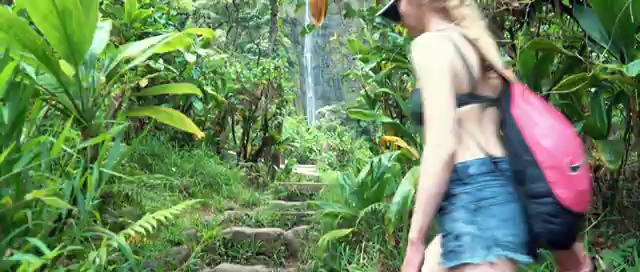

Frame Number: 9383


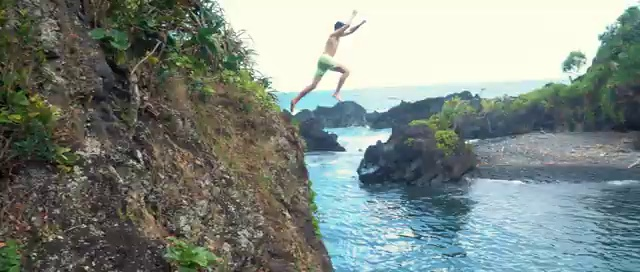

Frame Number: 9479


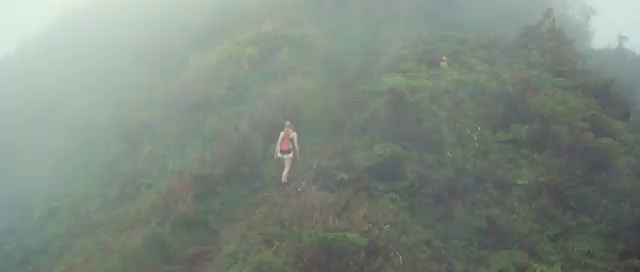

Frame Number: 6093


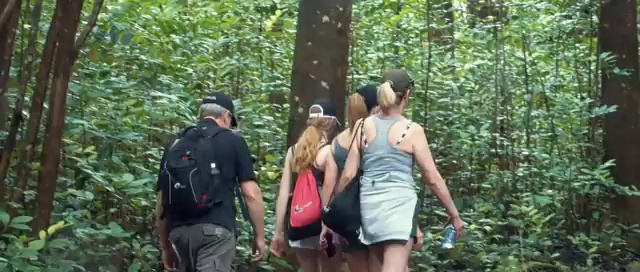

Frame Number: 6779


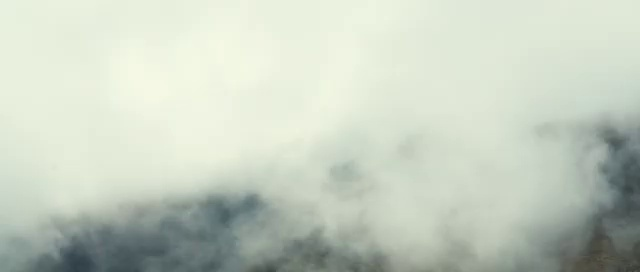

Frame Number: 3397


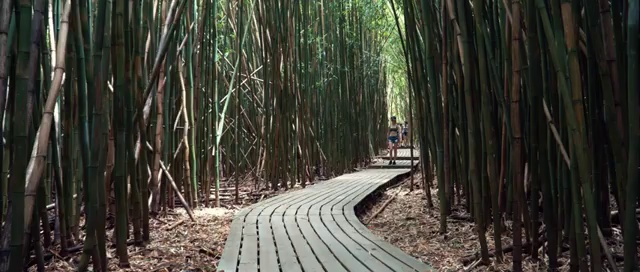

Frame Number: 4321


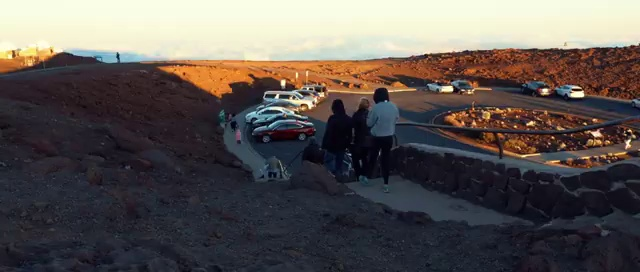

Frame Number: 2972


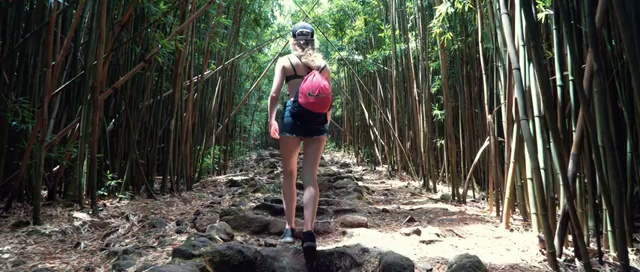

Frame Number: 256


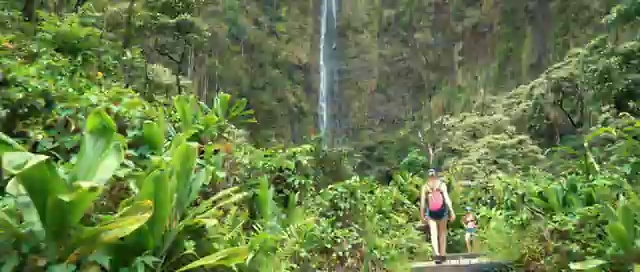

Frame Number: 9450


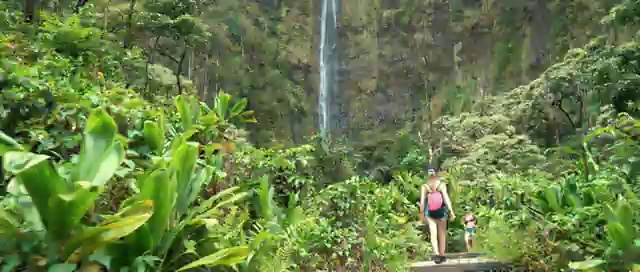

Frame Number: 5061


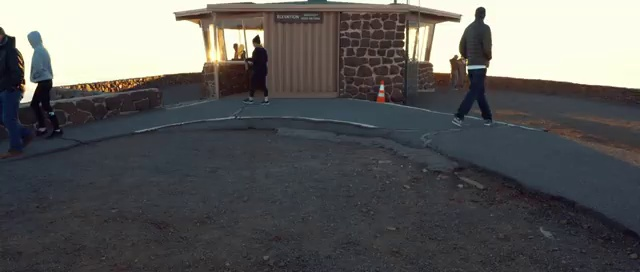

Frame Number: 5594


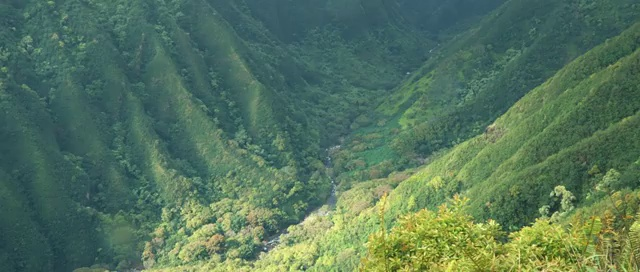

Frame Number: 5733


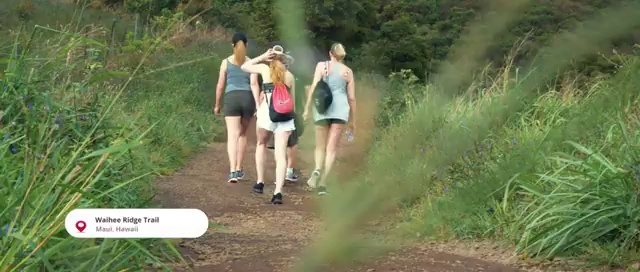

Frame Number: 1217


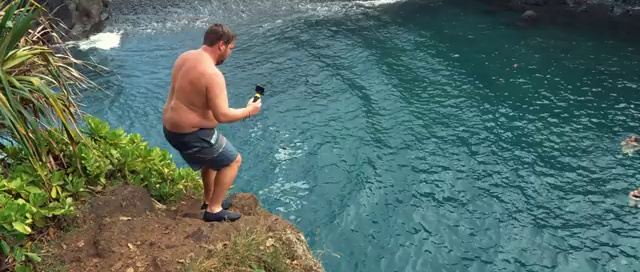

Frame Number: 7823


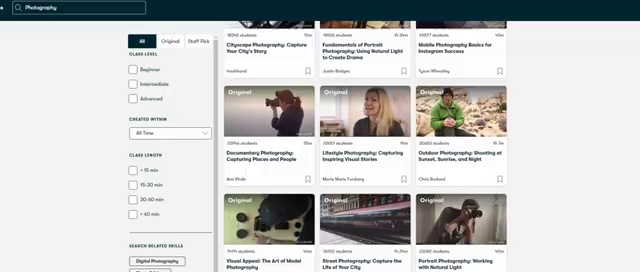

Frame Number: 5481


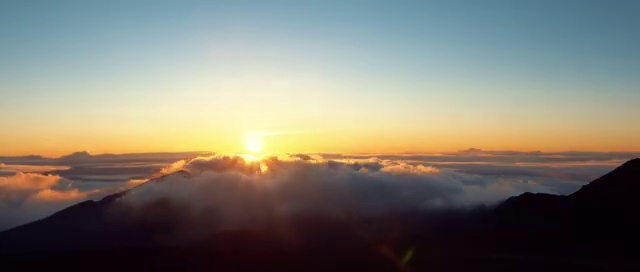

Frame Number: 4751


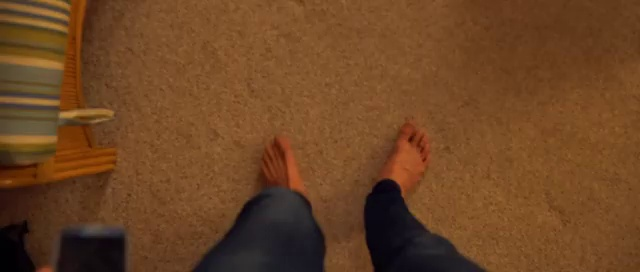

Frame Number: 2268


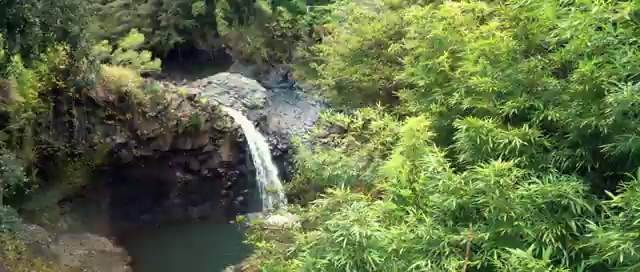

Frame Number: 7309


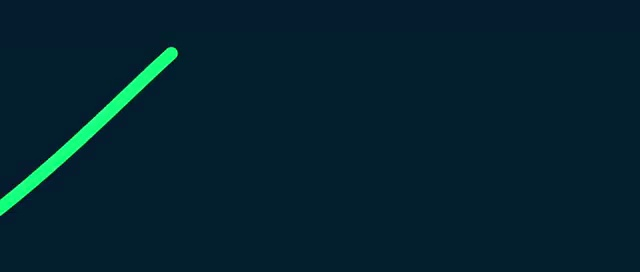

Frame Number: 427


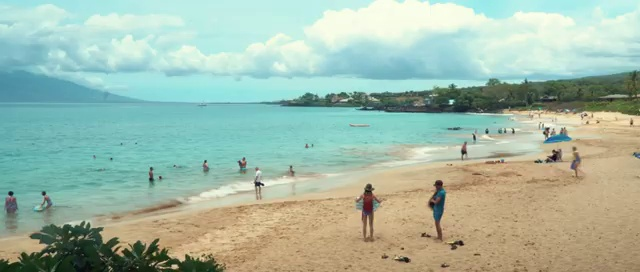

Frame Number: 2135


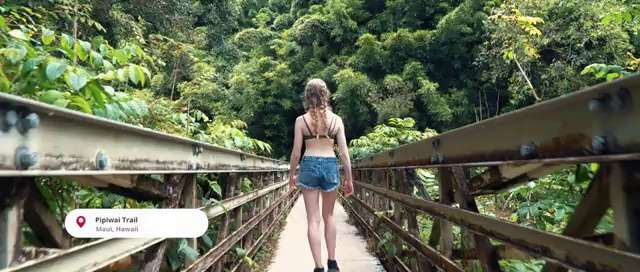

Frame Number: 8573


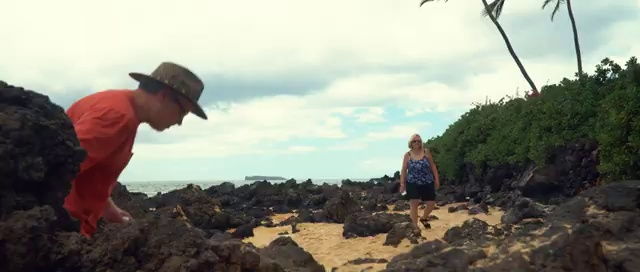

Frame Number: 7080


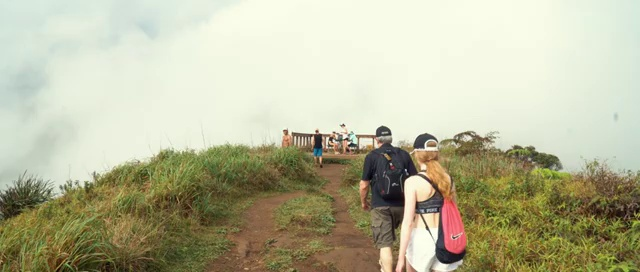

Frame Number: 4395


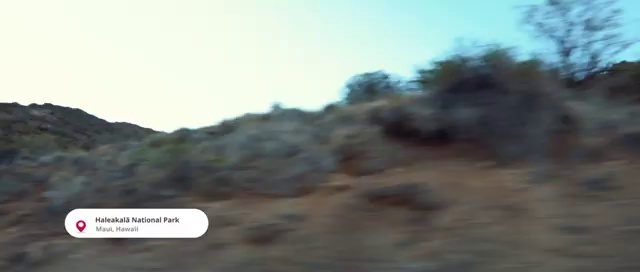

Frame Number: 8360


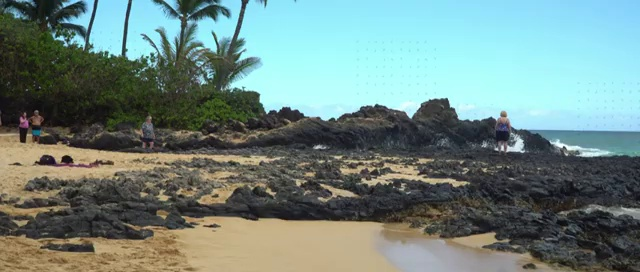

Frame Number: 189


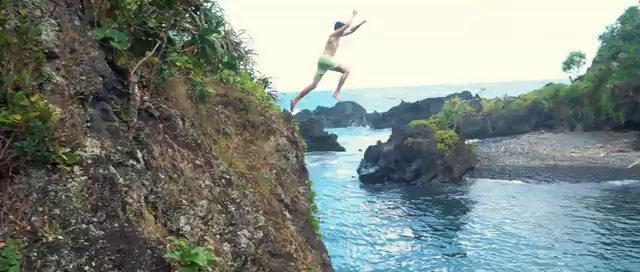

In [ ]:
#Plot Keyframes and frame ID
from matplotlib import pyplot as plt
from PIL import Image
import itertools 

for k, v in img_path_dict.items():
    print("Frame Number: {}".format(k))
    cv2_imshow(cv2.imread(v))


In [ ]:
from decord import VideoReader
from decord import cpu, gpu

vr = VideoReader(filename, ctx=cpu(0))
# a file like object works as well, for in-memory decoding
with open(filename, 'rb') as f:
  vr = VideoReader(f, ctx=cpu(0))
print('video frames:', len(vr))

video frames: 9917


# This code sequence feeds a batch of video frames starting at each detected key frame and uses the pretrained video activity detection to classify activities associated with each key frame. We can see that the model may need further finetuning based on chosen video content.

picking fruit


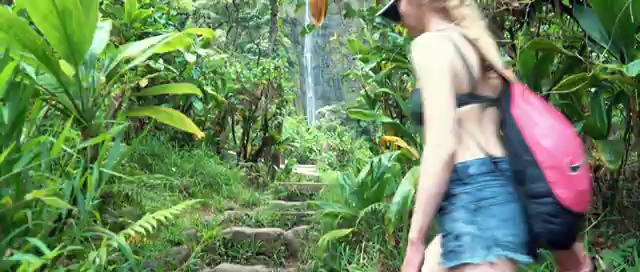

diving cliff


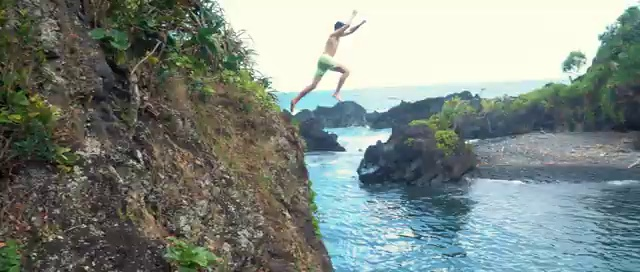

abseiling


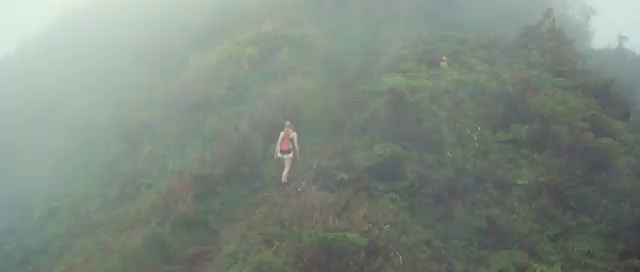

walking the dog


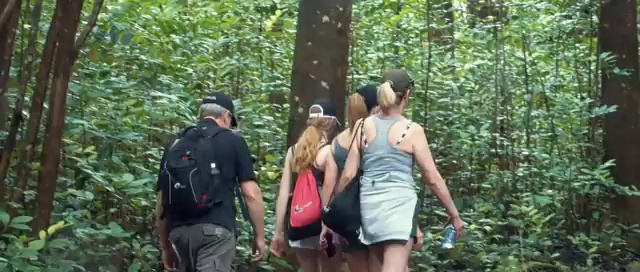

extinguishing fire


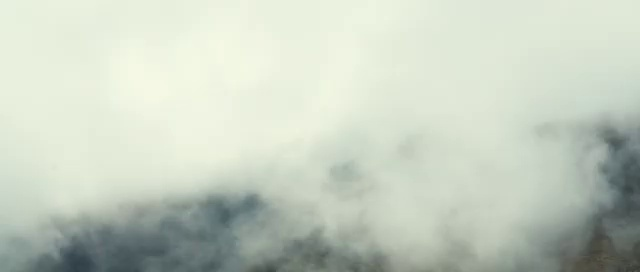

walking the dog


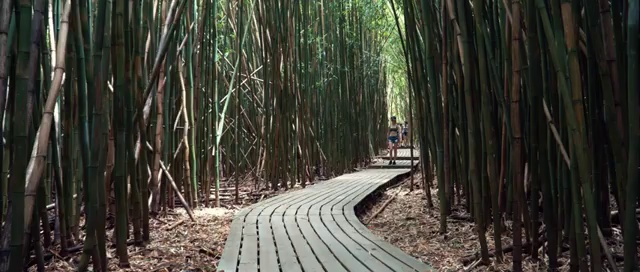

pushing car


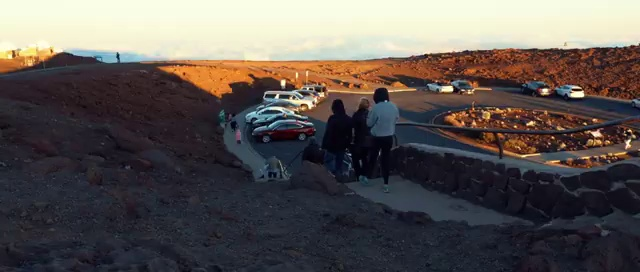

lunge


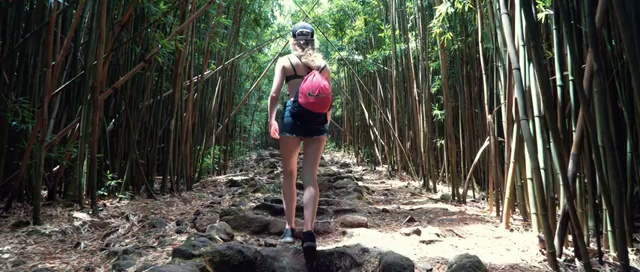

diving cliff


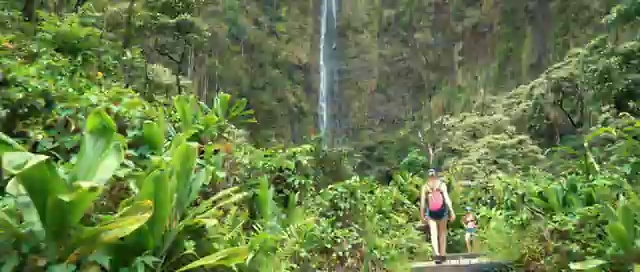

diving cliff


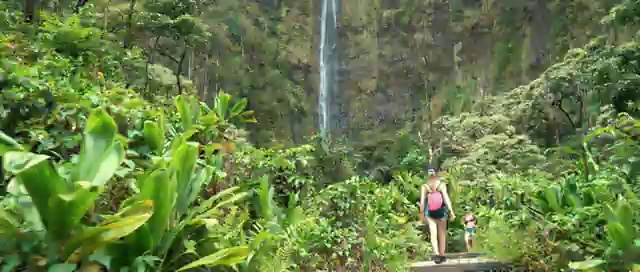

shot put


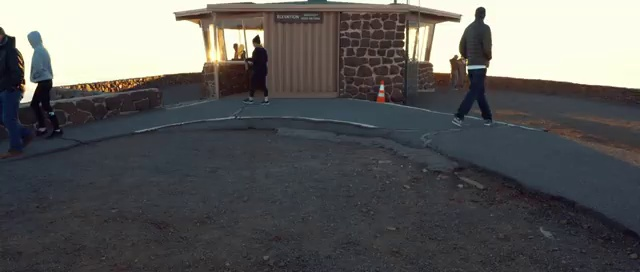

bungee jumping


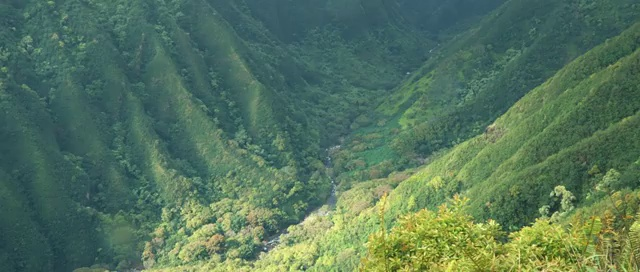

country line dancing


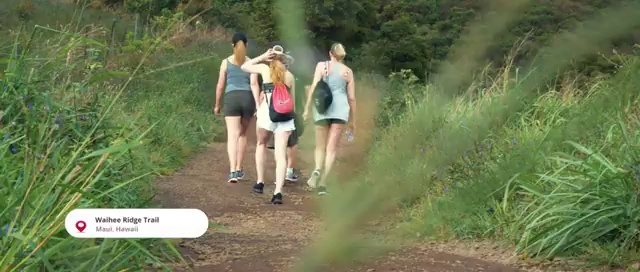

diving cliff


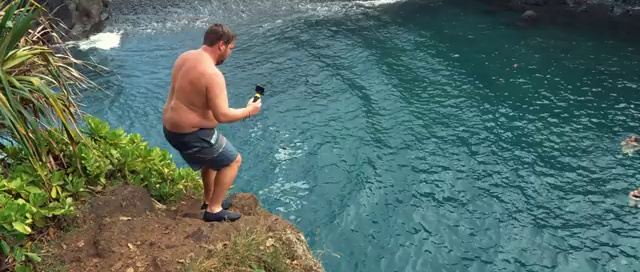

using computer


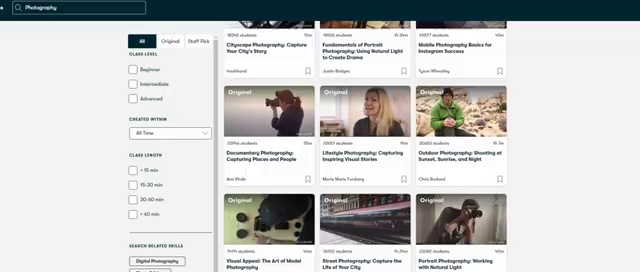

surfing water


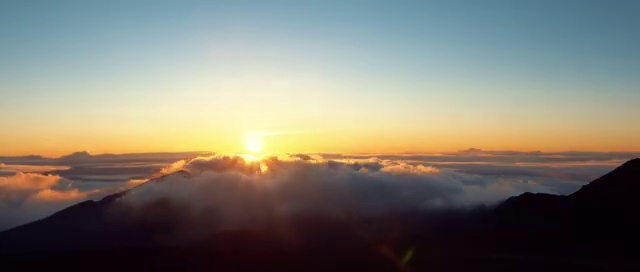

crawling baby


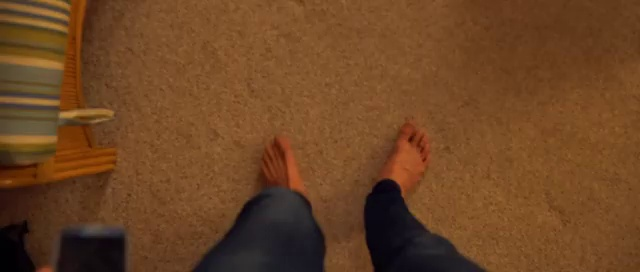

diving cliff


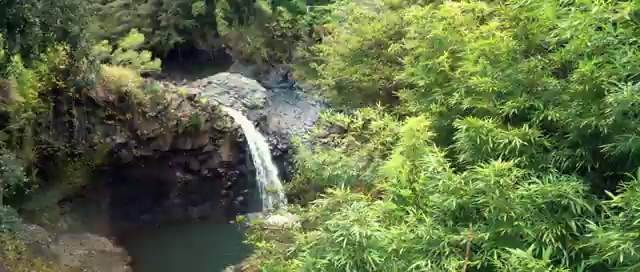

answering questions


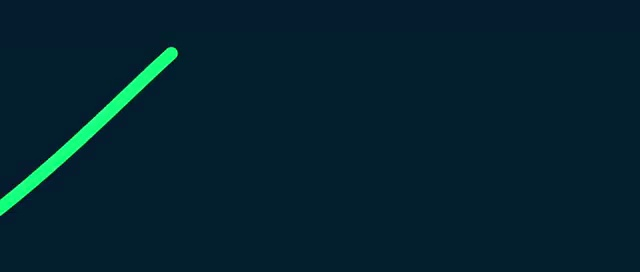

catching or throwing frisbee


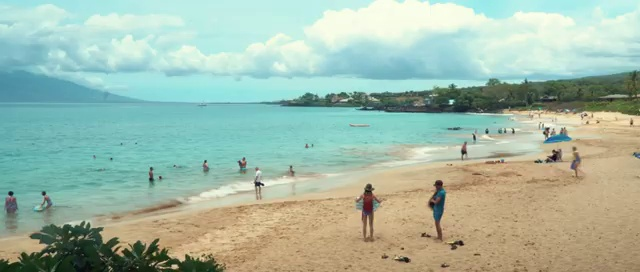

walking the dog


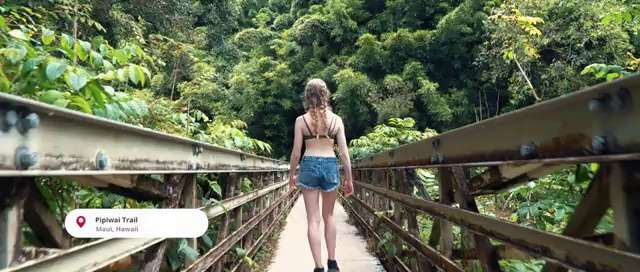

digging


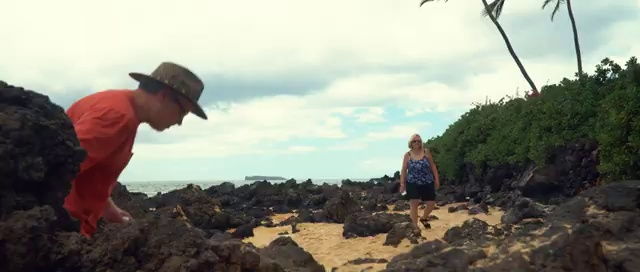

riding elephant


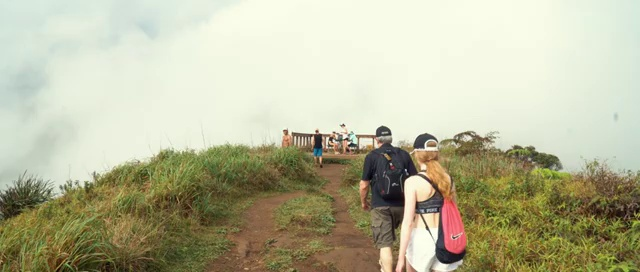

motorcycling


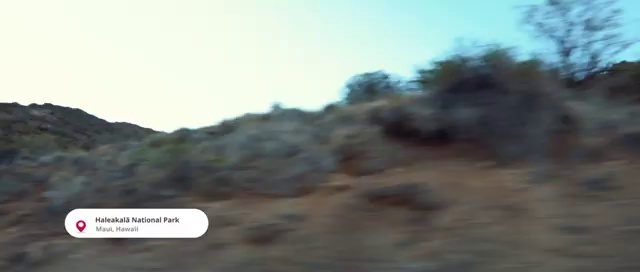

slacklining


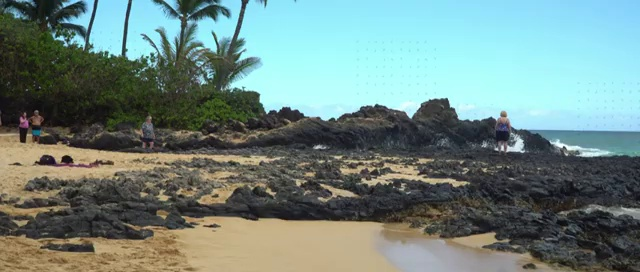

diving cliff


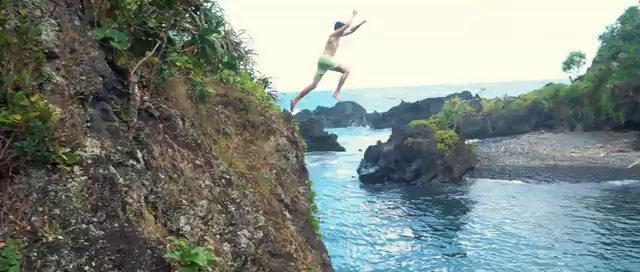

In [ ]:
import torch
import numpy as np
from transformers import VideoMAEFeatureExtractor, VideoMAEForVideoClassification

np.random.seed(0)

vr.seek(0)

feature_extractor = VideoMAEFeatureExtractor.from_pretrained("MCG-NJU/videomae-base-finetuned-kinetics")
model = VideoMAEForVideoClassification.from_pretrained("MCG-NJU/videomae-base-finetuned-kinetics")

for k, v in img_path_dict.items():
  batch_indices = list(range(k, k+16*2, 2))

  video = vr.get_batch(batch_indices).asnumpy()
  
  inputs = feature_extractor(list(video), return_tensors="pt")

  with torch.no_grad():
      outputs = model(**inputs)
      logits = outputs.logits

  # model predicts one of the 400 Kinetics-400 classes
  predicted_label = logits.argmax(-1).item()
  print(model.config.id2label[predicted_label])
  cv2_imshow(cv2.imread(v))